#Complete image training process, from start to end


## Data Management


### Google Drive

In [ ]:
# connect to google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# make sure we have all the images (training and mask)
%cd /content/drive/MyDrive/comma100/
!ls train  | wc -l
!ls train_mask | wc -l
!ls val  | wc -l
!ls val_mask | wc -l

/content/drive/MyDrive/comma100
75
75
26
26


### Image to coco


In [ ]:
# clone the mask to coco software
%cd /content
!git clone --branch dev https://github.com/Mrgove10/image-to-coco-json-converter
%cd image-to-coco-json-converter
!git pull 
%cd /content

/content
Cloning into 'image-to-coco-json-converter'...
remote: Enumerating objects: 92, done.
remote: Counting objects: 100% (92/92), done.
remote: Compressing objects: 100% (67/67), done.
remote: Total 92 (delta 36), reused 78 (delta 22), pack-reused 0
Unpacking objects: 100% (92/92), done.
/content/image-to-coco-json-converter
Already up to date.
/content


In [ ]:
!mkdir /content/imagesOutput
# generate the coco dataset based on the masks
# this can be skiped if the trains and val files are already done
# !python image-to-coco-json-converter/main.py --dataset /content/drive/MyDrive/comma100/ --output /content/drive/MyDrive/comma100/

dataset path : /content/drive/MyDrive/comma100/
output path : /content/drive/MyDrive/comma100/
found 75 masks
treating mask 1 / 75 (1.3%) 0009_ef53f1ffea65e93c_2018-07-26--03-48-48_14_191.png
treating mask 2 / 75 (2.7%) 0043_0c5c849415c7dba2_2018-08-28--06-57-10_10_828.png
treating mask 3 / 75 (4.0%) 0004_2ac95059f70d76eb_2018-05-12--17-46-52_56_371.png
treating mask 4 / 75 (5.3%) 0059_0afcc356dc79a1f8_2018-10-16--07-12-57_5_106.png
treating mask 5 / 75 (6.7%) 0040_48aa3d209af8b583_2018-07-14--16-52-45_44_543.png
treating mask 6 / 75 (8.0%) 0013_f550e313a9262051_2018-05-21--17-33-38_26_590.png
treating mask 7 / 75 (9.3%) 0029_b67de2c85620cf60_2018-10-02--17-04-44_7_747.png
treating mask 8 / 75 (10.7%) 0005_836d09212ac1b8fa_2018-06-15--15-57-15_23_345.png
treating mask 9 / 75 (12.0%) 0030_104c93f0dcbbaf5a_2018-10-10--14-31-04_57_149.png
treating mask 10 / 75 (13.3%) 0051_69753972bed747e4_2018-08-21--22-54-28_4_273.png
treating mask 11 / 75 (14.7%) 0061_24d8e3bdd70fc55d_2018-09-04--16-43

## Detectron

### install

In [ ]:
!pip install -U torch==1.7.0 torchvision==0.8.1
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
print(torch.__version__)
print(torchvision.__version__)

Requirement already up-to-date: torch==1.7.0 in /usr/local/lib/python3.6/dist-packages (1.7.0+cu101)
Requirement already up-to-date: torchvision==0.8.1 in /usr/local/lib/python3.6/dist-packages (0.8.1+cu101)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-8uxtn8a0
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-8uxtn8a0
     |████████████████████████████████| 276kB 8.0MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2-cp36-none-any.whl size=44576 sha256=9861e4c6a79f245497a606f0b63716edc80f1674fb5a1e498bb1d5f2ce76af3a
  Stored in directory: /tmp/pip-ephem-wheel-cache-w0wgxslv/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
  Created wheel for pyyaml: filename=PyYAML-5.3.1-cp36-cp36m-linux_x86_64.whl size=44621 sha256=c32ff252278961554321d1c7e215443692ee3e2fd023c462ed22d1cfca427f77
  Stored in directory: /root/.cache/pip/wheels/a7/c1/ea/cf5bd31012e735dc1dfea3131a2d5eae7978b251083d6247b

In [ ]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 26, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (23/23), done.
remote: Total 9623 (delta 4), reused 9 (delta 3), pack-reused 9597
Receiving objects: 100% (9623/9623), 3.86 MiB | 23.36 MiB/s, done.
Resolving deltas: 100% (7050/7050), done.
Obtaining file:///content/detectron2_repo
     |████████████████████████████████| 2.2MB 7.9MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0
  Running setup.py develop for detectron2


### Import

In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2

import datetime, os
# import some common detectron2 utilities
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
#clean outputs for tensorboard
!rm /content/output/events.*
!rm /content/output/metrics*
!rm /content/output/*
%load_ext tensorboard
import tensorflow as tf
import datetime, os
%tensorboard --logdir /content/output/

rm: cannot remove '/content/output/events.*': No such file or directory
rm: cannot remove '/content/output/metrics*': No such file or directory
rm: cannot remove '/content/output/*': No such file or directory


Reusing TensorBoard on port 6007 (pid 823), started 0:01:36 ago. (Use '!kill 823' to kill it.)

<IPython.core.display.Javascript object>

### Train

#### Create Datasets

In [ ]:
from detectron2.data.datasets import register_coco_instances
# main one : 
register_coco_instances("cars_train", {}, "/content/drive/MyDrive/comma100/train.json", "/content/drive/MyDrive/comma100/train")
register_coco_instances("cars_val", {}, "/content/drive/MyDrive/comma100/val.json", "/content/drive/MyDrive/comma100/val")

In [ ]:
car_train_metadata = MetadataCatalog.get("cars_train")
dataset_dicts = DatasetCatalog.get("cars_train")

WARNING [12/23 16:48:28 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/23 16:48:28 d2.data.datasets.coco]: Loaded 75 images in COCO format from /content/drive/MyDrive/comma100/train.json


#### Visialise dataset

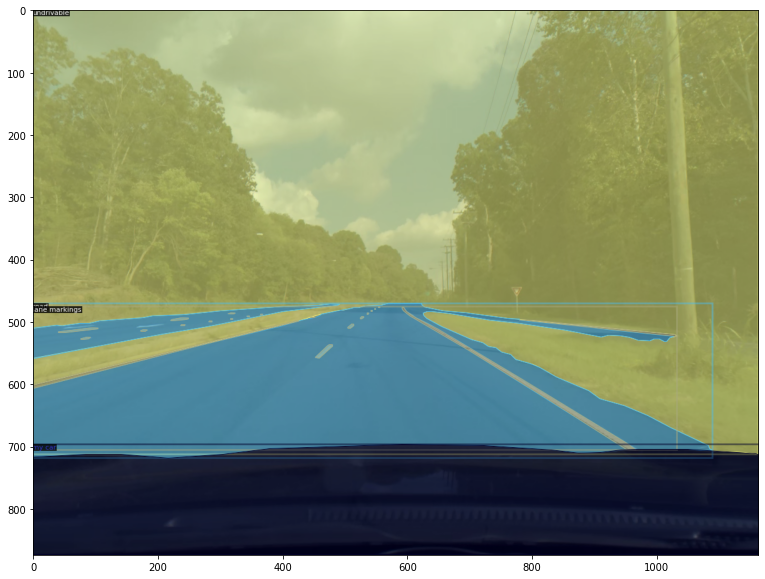

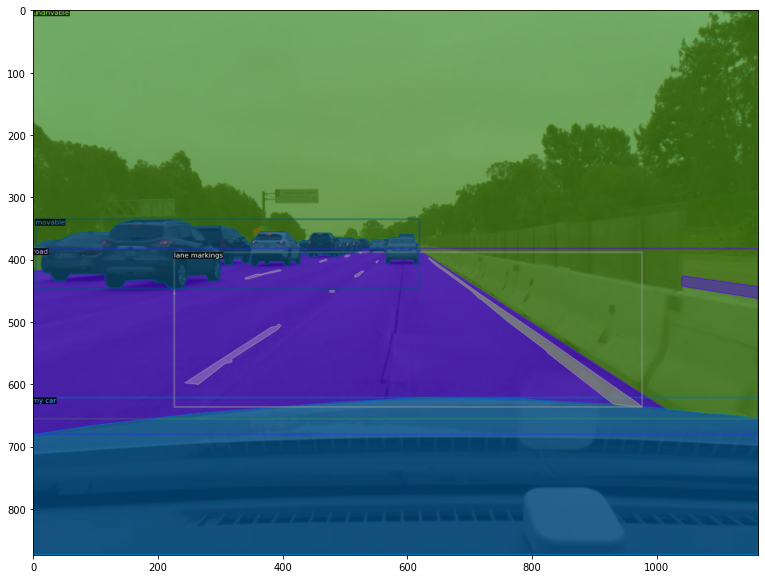

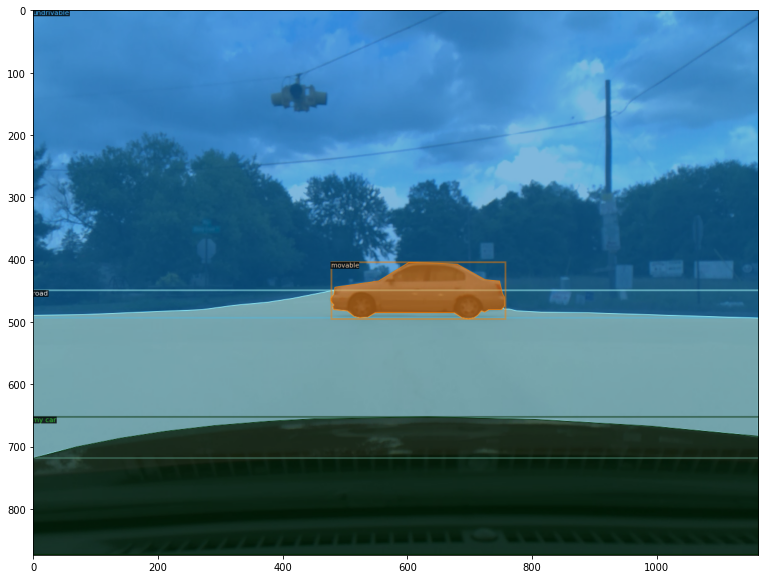

In [ ]:
import random

for d in random.sample(dataset_dicts, 3):
      img = cv2.imread(d["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=car_train_metadata, scale=1)
      vis = visualizer.draw_dataset_dict(d)
      plt.figure(figsize = (13,13))
      plt.imshow(vis.get_image())

#### configure training

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file("detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("cars_train",)
#https://medium.com/@apofeniaco/training-on-detectron2-with-a-validation-set-and-plot-loss-on-it-to-avoid-overfitting-6449418fbf4e
cfg.DATASETS.TEST = () #"cars_val"   # no metrics implemented for this dataset
#cfg.TEST.EVAL_PERIOD = 100
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02 #default : 0.02
cfg.SOLVER.MAX_ITER = 250    #default : 1000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # default 128 faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8  

#### train !

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/23 16:48:37 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (9, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (32, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (32,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (8, 256, 1, 1) 

[12/23 16:48:38 d2.engine.train_loop]: Starting training from iteration 0


/content/detectron2_repo/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/content/detectron2_repo/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/content/detectron2_repo/detectron2/modeling/roi_heads/fast_rcnn.py:225: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  num_fg

[12/23 16:48:44 d2.utils.events]:  eta: 0:01:13  iter: 19  total_loss: 2.61  loss_cls: 1.362  loss_box_reg: 0.3576  loss_mask: 0.6711  loss_rpn_cls: 0.1095  loss_rpn_loc: 0.1838  time: 0.3217  data_time: 0.0203  lr: 0.00039962  max_mem: 2339M
[12/23 16:48:51 d2.utils.events]:  eta: 0:01:08  iter: 39  total_loss: 1.742  loss_cls: 0.528  loss_box_reg: 0.5068  loss_mask: 0.5068  loss_rpn_cls: 0.04262  loss_rpn_loc: 0.147  time: 0.3264  data_time: 0.0071  lr: 0.00079922  max_mem: 2339M
[12/23 16:48:58 d2.utils.events]:  eta: 0:01:02  iter: 59  total_loss: 1.435  loss_cls: 0.3891  loss_box_reg: 0.4992  loss_mask: 0.3775  loss_rpn_cls: 0.03529  loss_rpn_loc: 0.1112  time: 0.3282  data_time: 0.0075  lr: 0.0011988  max_mem: 2339M
[12/23 16:49:04 d2.utils.events]:  eta: 0:00:56  iter: 79  total_loss: 1.263  loss_cls: 0.2949  loss_box_reg: 0.5218  loss_mask: 0.2789  loss_rpn_cls: 0.02331  loss_rpn_loc: 0.1156  time: 0.3302  data_time: 0.0063  lr: 0.0015984  max_mem: 2339M
[12/23 16:49:11 d2.util

### test

#### configure

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("cars", )
predictor = DefaultPredictor(cfg)

#### visualise test

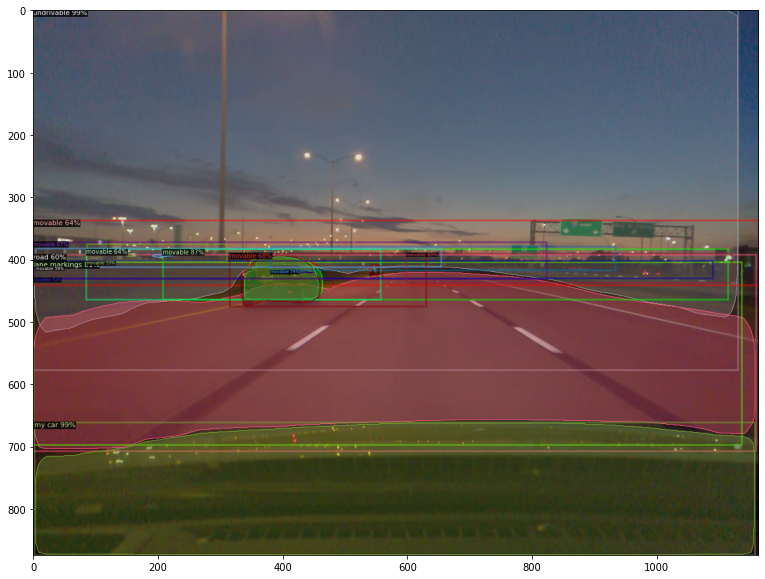

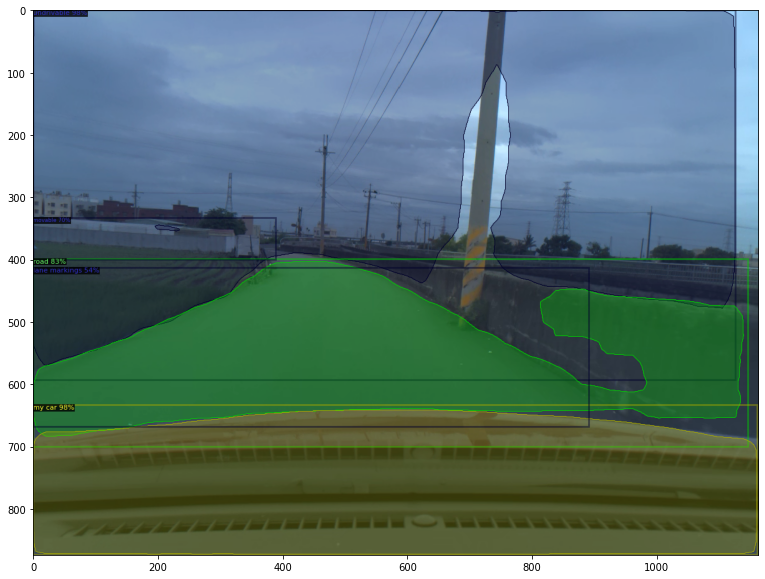

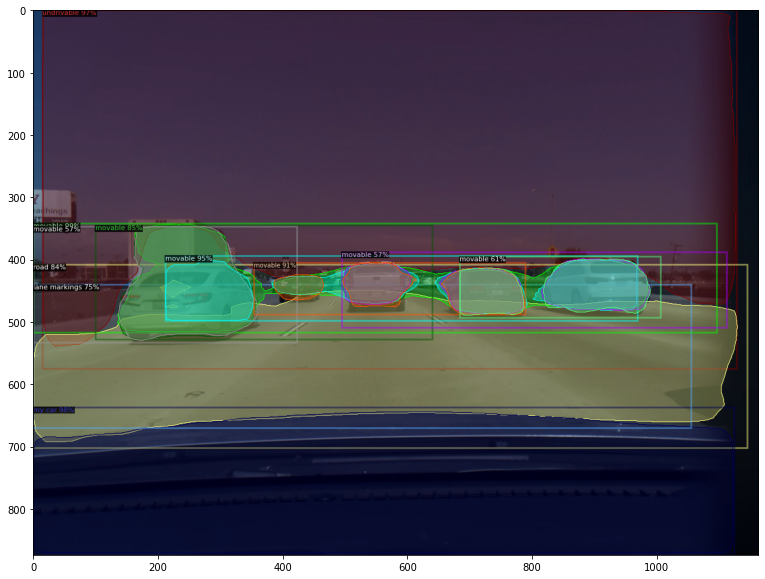

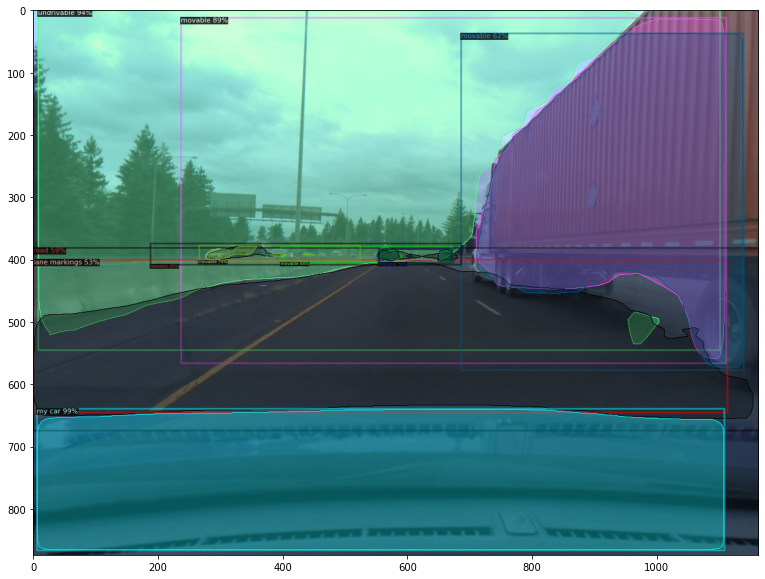

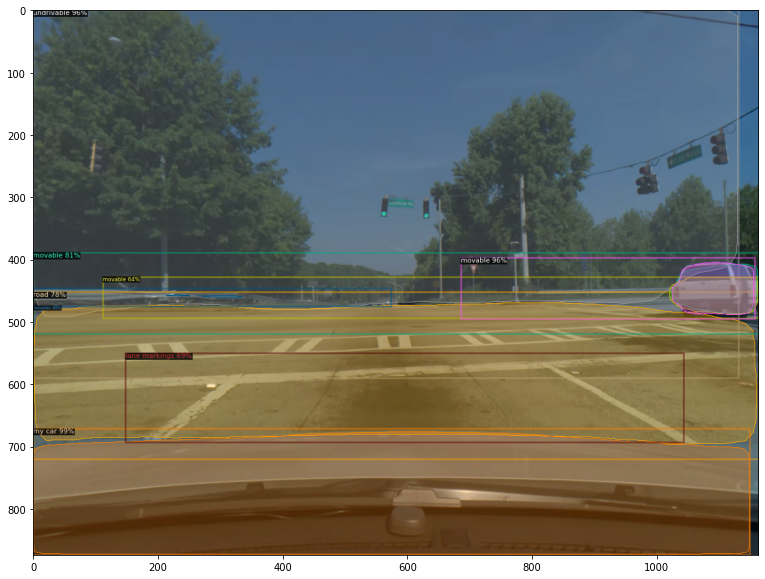

...

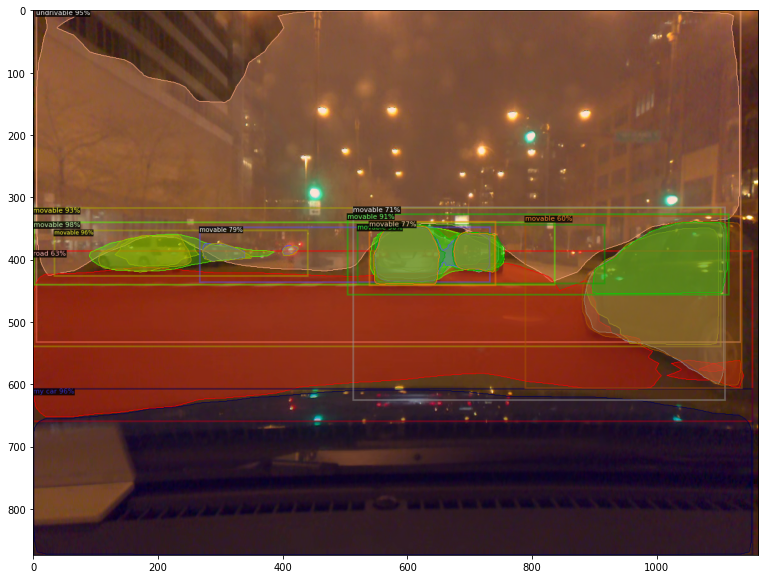

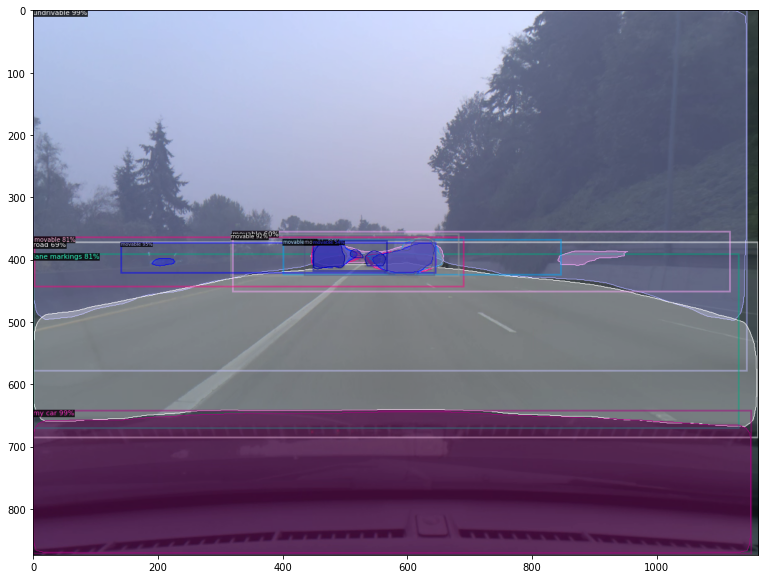

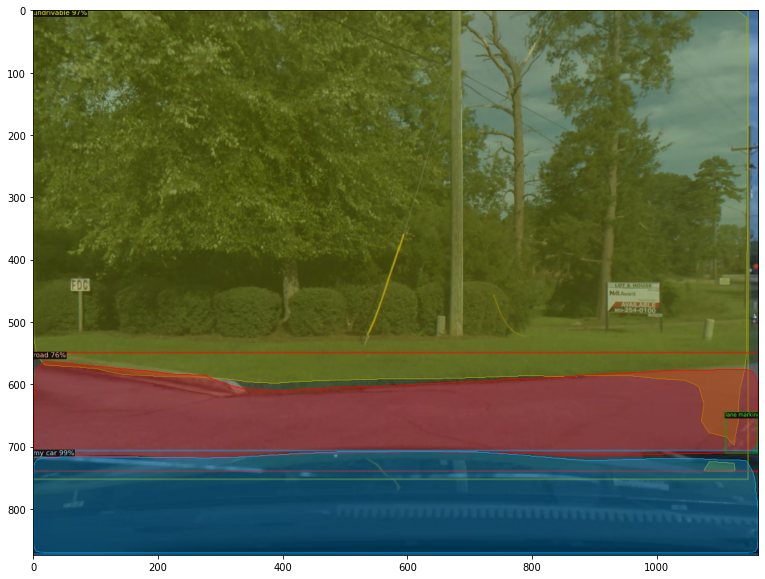

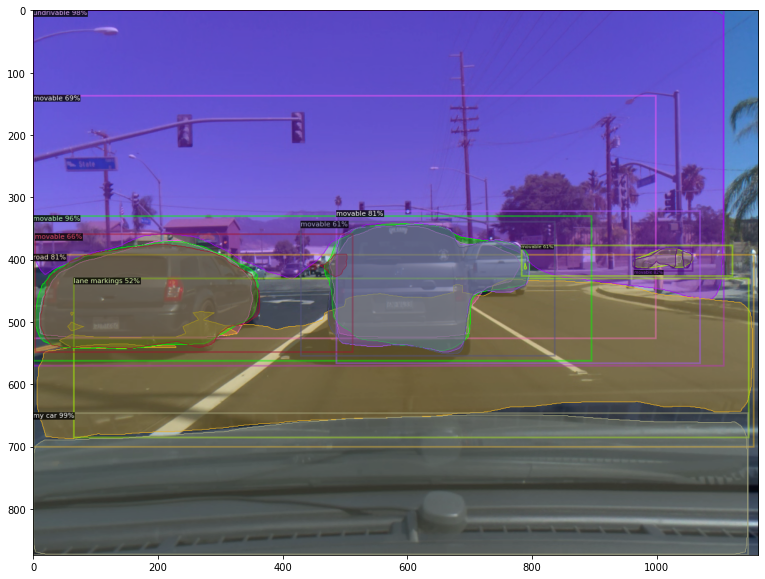

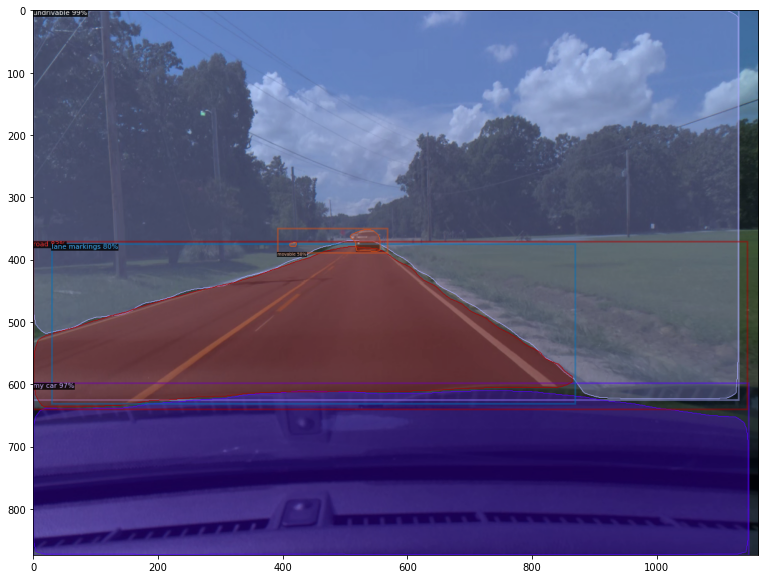

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 15):    
        im = cv2.imread(d["file_name"])
        outputs = predictor(im)
        v = Visualizer(im[:, :, ::-1],
                       metadata=car_train_metadata, 
                       scale=1, 
                       instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
        )
        v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        plt.figure(figsize = (13,13))
        plt.imshow(v.get_image())

In [ ]:
car_train_metadata

Metadata(evaluator_type='coco', image_root='/content/drive/MyDrive/comma100/train', json_file='/content/drive/MyDrive/comma100/train.json', name='cars_train', thing_classes=['road', 'lane markings', 'undrivable', 'movable', 'my car'], thing_dataset_id_to_contiguous_id={0: 0, 1: 1, 2: 2, 3: 3, 4: 4})

### Benchmark

In [ ]:
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.09,fps:11.06


In [ ]:
#!wget https://raw.githubusercontent.com/tensorpack/tensorpack/master/examples/FasterRCNN/convert_d2/convert_d2.py
!python convert_d2.py --d2-config /content/detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml --d2-pkl /content/output/model_final.pth --output R50FPN-d2-converted.npz
# the script will print tensorpack configs


'MODE_MASK=True' 'MODE_FPN=True' 'FPN.CASCADE=False' 'BACKBONE.STRIDE_1X1=True' 'PREPROC.PIXEL_MEAN=[123.675,116.28,103.53]' 'PREPROC.PIXEL_STD=[1.0,1.0,1.0]' Traceback (most recent call last):
  File "convert_d2.py", line 140, in <module>
    d2_dict = pickle.load(f)["model"]
_pickle.UnpicklingError: A load persistent id instruction was encountered,
but no persistent_load function was specified.
